LECTURE DES DONNEES

In [13]:
import pandas as pd
import numpy as np
import spotipy

In [14]:
data = pd.read_csv("C://Users//marcs//OneDrive//Documents//Spotify//data//data.csv")
genre_data = pd.read_csv("C://Users//marcs//OneDrive//Documents//Spotify//data//data_by_genres.csv")
year_data = pd.read_csv("C://Users//marcs//OneDrive//Documents//Spotify//data/data_by_year.csv")
artist_data = pd.read_csv("C://Users//marcs//OneDrive//Documents//Spotify//data//data_by_artist.csv")

In [15]:
data.head(2)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936


In [16]:
genre_data.head(2)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.3616,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.1310,-16.854000,0.076817,120.285667,0.221750,52.500000,5


In [17]:
year_data.head(2)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.20571,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.24072,-19.275282,0.116655,100.884521,0.535549,0.140845,10


In [18]:
artist_data.head(2)

,mode,count,acousticness,artists,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,9,0.590111,"""Cats"" 1981 Original London Cast",0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448,0.210389,117.518111,0.389500,38.333333,5
1,1,26,0.862538,"""Cats"" 1983 Broadway Cast",0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690,0.176212,103.044154,0.268865,30.576923,5


In [19]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [20]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [27]:
data['decade'] = data['year'].apply(lambda year : f'{(year//10)*10}s')

ANALYSE EXPLORATOIRE DES DONNEES

In [40]:
import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt


La musique au fil du temps


En utilisant les données regroupées par année, nous pouvons observer l'impact globale de la musique de 1921 à 2020.

<Axes: xlabel='count', ylabel='decade'>

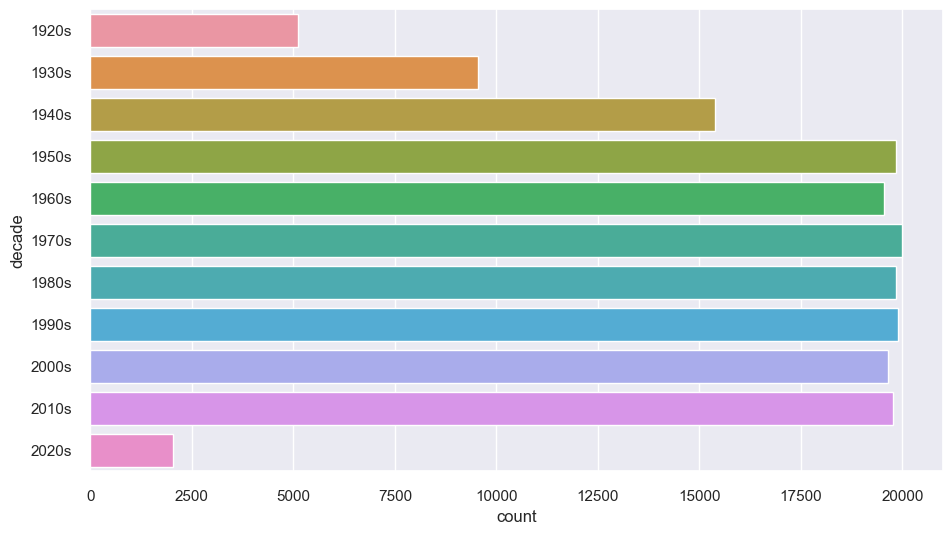

In [44]:
sns.countplot(data=data, y='decade', order=sorted(data['decade'].unique()))

In [47]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features,title='Tendance des différentes caractéristiques sonores au fil des décennies')
fig.show()

In [42]:
fig = px.line(year_data, x='year', y='loudness',title='Tendance du volume sonore au fil des décennies')
fig.show()

In [49]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group',
            title='Tendance des différentes caractéristiques sonores du Top 10 des genres')
fig.show()

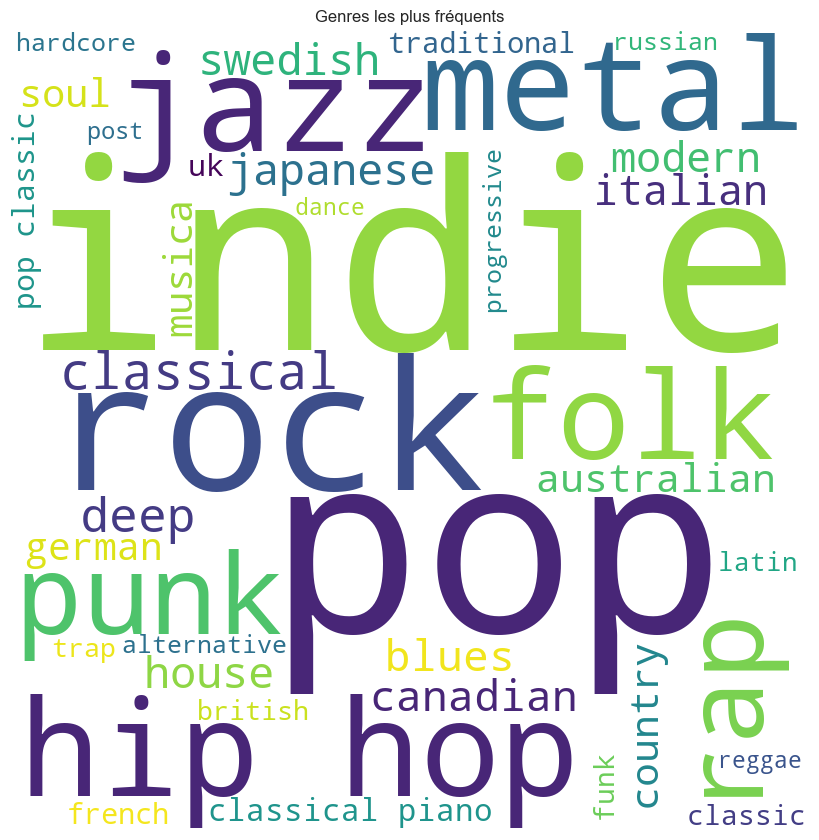

In [52]:
from wordcloud import WordCloud,STOPWORDS

stopwords = set(STOPWORDS)
comment_words = " ".join(genre_data['genres'])+" "
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                max_words=40,
                min_font_size = 10).generate(comment_words)
                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Genres les plus fréquents")
plt.show()

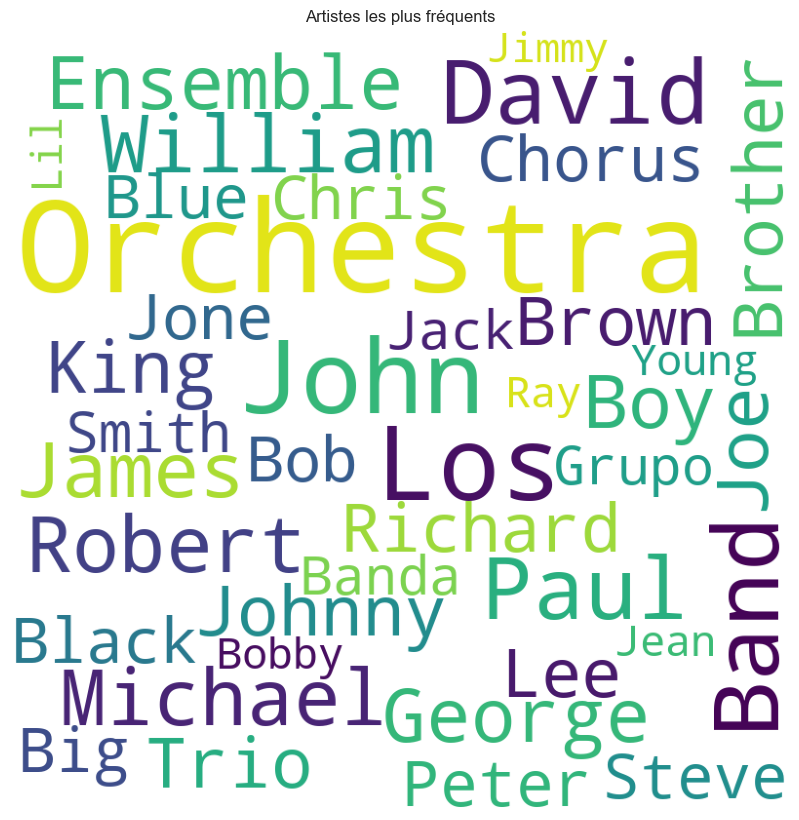

In [53]:
stopwords = set(STOPWORDS)
comment_words = " ".join(artist_data['artists'])+" "
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_word_length=3,
                max_words=40,
                min_font_size = 10).generate(comment_words)
                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.title("Artistes les plus fréquents")
plt.tight_layout(pad = 0)
plt.show()

In [54]:
top10_popular_artists = artist_data.nlargest(10, 'popularity')
top10_most_song_produced_artists = artist_data.nlargest(10, 'count')

In [55]:
print('Top 10 des Artistes qui ont produit le plus de chansons:')
top10_most_song_produced_artists[['count','artists']].sort_values('count',ascending=False)

Top 10 des Artistes qui ont produit le plus de chansons:


,count,artists
8367,3169,Francisco Canaro
28561,2422,Эрнест Хемингуэй
28560,2136,Эрих Мария Ремарк
8434,1459,Frank Sinatra
10714,1256,Ignacio Corsini
27109,1200,Vladimir Horowitz
1682,1146,Arturo Toscanini
2707,1103,Billie Holiday
12378,1061,Johnny Cash
7426,1023,Elvis Presley


Conclusion de l'EDA

La plupart des chansons s'étalent sur la période allant des années 1950 aux années 2010.
L'énergie des chansons a augmenté au fil du temps.
L'acoustique des chansons a considérablement diminué au fil des décennies.
Nous pouvons clairement voir que le volume sonore a nettement augmenté au fil des décennies et atteint son pic en 2020.
Parmi les 10 genres les plus populaires, l'énergie et la dansabilité sont les caractéristiques les plus remarquables.

Clustering

Ici, le simple algorithme de regroupement K-means est utilisé pour diviser les genres de cet ensemble de données en 12 groupes en fonction des caractéristiques audio numériques de chaque genre.

In [56]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=12))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

c:\Users\marcs\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning:

Could not find the number of physical cores for the following reason:
[WinError 2] Le fichier spécifié est introuvable
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.

  File "c:\Users\marcs\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
               ^^^^^^^^^^^^^^^
  File "c:\Users\marcs\AppData\Local\Programs\Python\Python311\Lib\subprocess.py", line 548, in run
    with Popen(*popenargs, **kwargs) as process:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\marcs\AppData\Local\Programs\Python\Python311\Lib\subprocess.py", line 1024, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "c:\Users\marcs\

In [58]:
''' Visualiser les clusters avec t-SNE
 est un algorithme de Machine Learning non supervisé.
 Il est devenu largement utilisé en bioinformatique et plus généralement en science des données pour visualiser la structure de
 données de grande dimension en 2 ou 3 dimensions.
 Bien que le t-SNE soit une technique de réduction de dimensionnalité, elle est principalement utilisée pour la visualisation et non pour le prétraitement des données.
 (comme vous le feriez avec PCA). Pour cette raison, vous réduisez presque toujours la dimensionnalité à 2 avec t-SNE,
 afin que vous puissiez ensuite tracer les données en deux dimensions.
'''

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X) # returns np-array of coordinates(x,y) for each record after TSNE.
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'],title='Clusters des genres')
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.021s...
[t-SNE] Computed neighbors for 2973 samples in 0.708s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106216
[t-SNE] KL divergence after 1000 iterations: 1.392335


In [59]:

song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=25, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [60]:
'''
 Visualiser les clusters avec PCA
L'analyse en composantes principales est un algorithme d'apprentissage non supervisé utilisé pour la réduction de dimensionnalité dans l'apprentissage automatique.
L'une des différences les plus importantes entre PCA et t-SNE est qu'il ne préserve que les similitudes locales alors que PA préserve
une grande distance par paire maximise la variance. Il prend un ensemble de points dans des données de grande dimension et le convertit en données de faible dimension.
'''
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'],title='Clusters of songs')
fig.show()

MODELE

Sur la base de l'analyse et des visualisations, il est clair que les genres similaires ont tendance à avoir des points de données situés à proximité les uns des autres, tandis que des types de chansons similaires sont également regroupés ensemble.

Cette observation est logique. Les genres similaires auront des sonorités similaires et proviendront de périodes similaires, tout comme les chansons au sein de ces genres. Nous pouvons utiliser cette idée pour construire un système de recommandation en prenant les points de données des chansons qu'un utilisateur a écoutées et en recommandant des chansons correspondant à des points de données voisins.

In [61]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict



CLIENT_ID = "0c44dd32dc264ffc925263348f8df5f1"
CLIENT_SECRET = "33895e274f454993b57d91ccf2753e01"

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=CLIENT_ID, 
                                                           client_secret=CLIENT_SECRET))

In [62]:
'''
Trouver les détails des chansons dans l'ensemble de données de Spotify. 
Si la chanson n'est pas disponible dans l'ensemble de données, cela renvoie None.
'''
def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    
    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [63]:
number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

In [64]:
''''
Récupère les détails des chansons à partir de l'ensemble de données. 
Si les informations ne sont pas disponibles dans l'ensemble de données,
il recherchera les détails dans l'ensemble de données Spotify.

'''


def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        print('Fetching song information from local dataset')
        return song_data
    
    except IndexError:
        print('Fetching song information from spotify dataset')
        return find_song(song['name'], song['year'])

In [65]:
'''
Récupèrer les informations sur les chansons à partir de l'ensemble de données 
et calculer la moyenne de toutes les caractéristiques numériques des données des chansons
'''
def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))#nd-array where n is number of songs in list. It contains all numerical vals of songs in sep list.
    #print(f'song_matrix {song_matrix}')
    return np.mean(song_matrix, axis=0) # mean of each ele in list, returns 1-d array

In [66]:
'''
linéariser le dictionnaire en regroupant la clé et en formant une liste de valeurs pour la clé respective..
'''
def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()
    for key in dict_list[0].keys(): 
        flattened_dict[key] = [] # 'name', 'year'
    for dic in dict_list:
        for key,value in dic.items():
            flattened_dict[key].append(value) # creating list of values
    return flattened_dict

In [71]:
'''
Mettre à l'échelle l'entrée moyenne ainsi que les caractéristiques numériques de l'ensemble de données.
Calculer la distance euclidienne entre l'entrée moyenne et l'ensemble de données.
Récupérer les 10 meilleures chansons avec la similarité maximale.

'''
import scipy
from scipy.spatial.distance import cdist



def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    #print(f'song_center {song_center}')
    scaler = song_cluster_pipeline.steps[0][1] # StandardScalar()
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    #print(f'distances {distances}')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [73]:
recommend_songs([{'name': 'Dior', 'year': 2019}],  data)

Fetching song information from spotify dataset


c:\Users\marcs\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



[{'name': 'Hennessy and Moscato',
  'year': 2019,
  'artists': "['Shakur Luciano']"},
 {'name': 'Survival', 'year': 2018, 'artists': "['Drake']"},
 {'name': 'Perfect Time', 'year': 2019, 'artists': "['Roddy Ricch']"},
 {'name': 'No Lames (feat. Summer Walker)',
  'year': 2019,
  'artists': "['Kash Doll', 'Summer Walker']"},
 {'name': 'Nonchalant', 'year': 2018, 'artists': "['6LACK']"},
 {'name': 'I Sip', 'year': 2017, 'artists': "['Tory Lanez']"},
 {'name': 'Missing My Idols', 'year': 2018, 'artists': "['Trippie Redd']"},
 {'name': 'Growing Apart (To Get Closer)',
  'year': 2010,
  'artists': "['Kendrick Lamar', 'Jhené Aiko']"},
 {'name': 'II. No Exit', 'year': 2013, 'artists': "['Childish Gambino']"},
 {'name': 'November 18th', 'year': 2009, 'artists': "['Drake']"}]

CONCLUSION

Nous sommes en mesure de recommander les 10 chansons les plus similaires à l'utilisateur en fonction de l'entrée fournie. La recommandation est basée sur la similarité des caractéristiques numériques des chansons. Nous avons calculé la distance cosinus et identifié les chansons présentant la plus grande similarité.